In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
data = pd.read_csv('train.csv', sep=",", encoding = "ISO-8859-1")

In [4]:
df = data.copy()

In [5]:
df.shape

(49320, 22)

In [6]:
df.head()

,id,LoanNr_ChkDgt,Name,City,State,Bank,BankState,ApprovalDate,ApprovalFY,NoEmp,...,RetainedJob,FranchiseCode,UrbanRural,RevLineCr,LowDoc,ChgOffDate,DisbursementDate,DisbursementGross,BalanceGross,Accept
0,d30838cf806,6340864010,QUALITY DOCUMENT SOLUTIONS INC,ODESSA,TX,WELLS FARGO BANK NATL ASSOC,SD,22-May-03,2003,10,...,10,1,1,0,N,NaN,30-Jun-03,"$150,000.00",$0.00,1
1,14560b856a6,1670916004,ATLANTIC INDUSTRIAL WOOD PRODU,KELLER,TX,WELLS FARGO BANK NATL ASSOC,CA,7-Apr-06,2006,1,...,1,1,1,Y,N,NaN,31-Jul-06,"$250,000.00",$0.00,1
2,051e5c3899f,7568313003,C J TREEHOUSE INC.,EL PASO,TX,BANK OF AMERICA NATL ASSOC,TX,12-Sep-94,1994,5,...,0,1,0,N,Y,NaN,31-Oct-94,"$53,000.00",$0.00,1
3,eb223b05ea8,4585814005,WINGSTOP,SAN ANTONIO,TX,COMPASS BANK,AL,18-Jun-01,2001,1,...,1,89769,1,0,N,NaN,31-Aug-01,"$170,000.00",$0.00,1
4,c80c89ac964,2003866003,H & H MACHINE & SUPPLY INC,ODESSA,TX,SOUTHWEST BANK,TX,12-May-06,2006,5,...,5,1,1,0,N,NaN,31-May-06,"$121,000.00",$0.00,1


In [7]:
df.dtypes

id                    object
LoanNr_ChkDgt          int64
Name                  object
City                  object
State                 object
Bank                  object
BankState             object
ApprovalDate          object
ApprovalFY            object
NoEmp                  int64
NewExist             float64
CreateJob              int64
RetainedJob            int64
FranchiseCode          int64
UrbanRural             int64
RevLineCr             object
LowDoc                object
ChgOffDate            object
DisbursementDate      object
DisbursementGross     object
BalanceGross          object
Accept                 int64
dtype: object

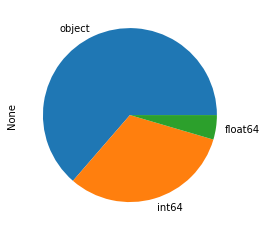

In [8]:
df.dtypes.value_counts().plot.pie()

There are many data with types "Object"

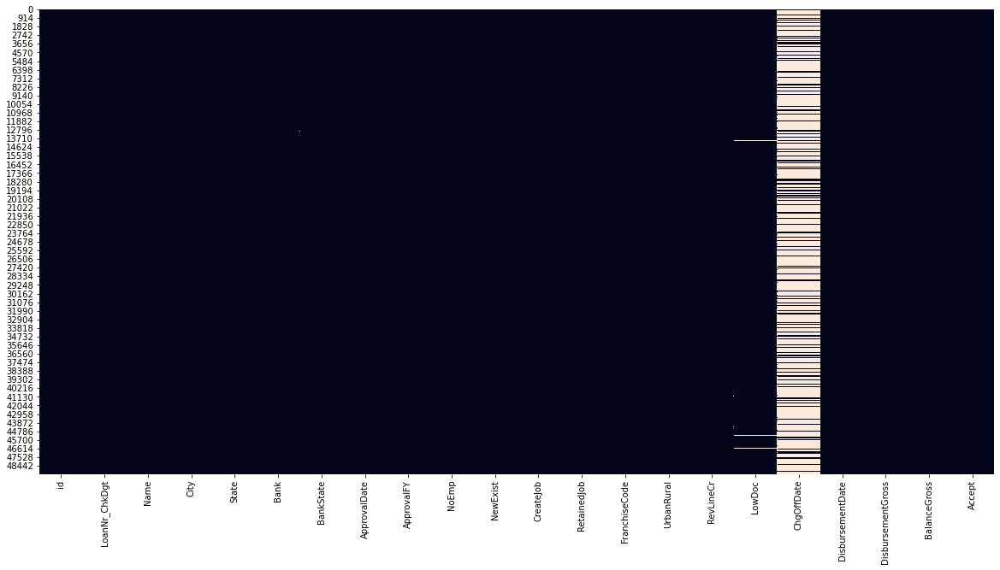

In [9]:
plt.figure(figsize=(20,10))
sns.heatmap(df.isna(), cbar=False)

In [10]:
(df.isna().sum()/df.shape[0]).sort_values(ascending=True)

id                   0.000000
DisbursementGross    0.000000
UrbanRural           0.000000
FranchiseCode        0.000000
RetainedJob          0.000000
CreateJob            0.000000
BalanceGross         0.000000
NoEmp                0.000000
Accept               0.000000
ApprovalDate         0.000000
State                0.000000
City                 0.000000
LoanNr_ChkDgt        0.000000
ApprovalFY           0.000000
Name                 0.000020
NewExist             0.000142
DisbursementDate     0.002555
LowDoc               0.003244
BankState            0.004055
Bank                 0.004055
RevLineCr            0.005860
ChgOffDate           0.805941
dtype: float64

We can delete the column "ChgOffDate" because 80% is NaN

In [11]:
df.drop(['ChgOffDate'], axis=1, inplace=True)

We can delete the column 'State' because we only have the value 'TX'.

In [12]:
df.drop(['State'], axis=1, inplace=True)

We can delete the column 'BalanceGross' because we only have the value '$0.00 '.

In [13]:
df.drop(['BalanceGross'], axis=1, inplace=True)

We can remove the 'id' column which is useless for the learning of our machine learning model since each value is unique.

In [14]:
df.drop(['id'], axis=1, inplace=True)

In [15]:
df.shape

(49320, 18)

## DisbursementGross

Let's change the format of the "DisbursementGross" column from this 30-Jun-03 to 3 columns with the day, the moth and the year associated.

In [16]:
df['DisbursementDate']

0        30-Jun-03
1        31-Jul-06
2        31-Oct-94
3        31-Aug-01
4        31-May-06
           ...    
49315    31-Mar-02
49316    30-Sep-05
49317    31-Jan-94
49318    31-Oct-07
49319    31-Dec-96
Name: DisbursementDate, Length: 49320, dtype: object

We change the format into datetime

In [17]:
df['DisbursementDate'] = pd.to_datetime(data['DisbursementDate'])

We create new columns ''DisbursementDay', 'DisbursementMonth', 'DisbursementYear'

In [18]:
df['DisbursementDay'] = df['DisbursementDate'].apply(lambda x: x.day)

In [19]:
df['DisbursementDay']

0        30.0
1        31.0
2        31.0
3        31.0
4        31.0
         ... 
49315    31.0
49316    30.0
49317    31.0
49318    31.0
49319    31.0
Name: DisbursementDay, Length: 49320, dtype: float64

In [20]:
df['DisbursementMonth'] = df['DisbursementDate'].apply(lambda x: x.month)

In [21]:
df['DisbursementMonth'] 

0         6.0
1         7.0
2        10.0
3         8.0
4         5.0
         ... 
49315     3.0
49316     9.0
49317     1.0
49318    10.0
49319    12.0
Name: DisbursementMonth, Length: 49320, dtype: float64

In [22]:
df['DisbursementYear'] = df['DisbursementDate'].apply(lambda x: x.year)

In [23]:
df['DisbursementYear'] 

0        2003.0
1        2006.0
2        1994.0
3        2001.0
4        2006.0
          ...  
49315    2002.0
49316    2005.0
49317    1994.0
49318    2007.0
49319    1996.0
Name: DisbursementYear, Length: 49320, dtype: float64

We can now delete the 'DisbursementDate' column.

In [24]:
df.drop(['DisbursementDate'], axis=1, inplace=True)

## ApprovalDate

Let's change the format of the "ApprovalDate" column from this 30-Jun-03 to 3 columns with the day, the moth and the year associated.

In [25]:
df['ApprovalDate']

0        22-May-03
1         7-Apr-06
2        12-Sep-94
3        18-Jun-01
4        12-May-06
           ...    
49315    23-Oct-01
49316     4-Aug-05
49317     3-Aug-93
49318    21-Sep-07
49319     9-Jul-96
Name: ApprovalDate, Length: 49320, dtype: object

In [26]:
df['ApprovalDate'] = pd.to_datetime(data['ApprovalDate'])

In [27]:
df['ApprovalDay'] = df['ApprovalDate'].apply(lambda x: x.day)
df['ApprovalMonth'] = df['ApprovalDate'].apply(lambda x: x.month)
df['ApprovalYear'] = df['ApprovalDate'].apply(lambda x: x.year)

In [28]:
df.drop(['ApprovalDate'], axis=1, inplace=True)

## DisbursementGross

Let's change the format of the "DisbursementGross" column from this $ 150,000.00 to 150000.

In [29]:
df['DisbursementGross']

0        $150,000.00 
1        $250,000.00 
2         $53,000.00 
3        $170,000.00 
4        $121,000.00 
             ...     
49315     $63,000.00 
49316     $25,000.00 
49317    $200,000.00 
49318     $35,000.00 
49319     $90,000.00 
Name: DisbursementGross, Length: 49320, dtype: object

In [30]:
def clean_currency(x):
   
    if isinstance(x, str):
        return(x.replace('$', '').replace(',', ''))
    return(x)

In [31]:
df['DisbursementGross'] = df['DisbursementGross'].apply(clean_currency).astype('float')

In [32]:
df['DisbursementGross']

0        150000.0
1        250000.0
2         53000.0
3        170000.0
4        121000.0
           ...   
49315     63000.0
49316     25000.0
49317    200000.0
49318     35000.0
49319     90000.0
Name: DisbursementGross, Length: 49320, dtype: float64

## For the other columns of type 'Object' we will create a function which associates to the Strings a value.

### Name

In [33]:
name = []

lista_1 = dict()

for i in range (0, 49320):
    
    name.append(df['Name'][i])
    
for j in range (0, 49320):
        
    if df['Name'][j] not in lista_1:
        
        
        c = name[j]
        
        df['Name'][j] = j
    
        lista_1[c] = j
        
        print(c)
        
        print(df['Name'][j])
        
        print(lista_1)
        
    else :
        
        df['Name'][j] = lista_1[df['Name'][j]]
    

<ipython-input-33-b1bdc57cda24>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Name'][j] = j


QUALITY DOCUMENT SOLUTIONS INC
0
{'QUALITY DOCUMENT SOLUTIONS INC': 0}
ATLANTIC INDUSTRIAL WOOD PRODU
1
{'QUALITY DOCUMENT SOLUTIONS INC': 0, 'ATLANTIC INDUSTRIAL WOOD PRODU': 1}
C J TREEHOUSE INC.
2
{'QUALITY DOCUMENT SOLUTIONS INC': 0, 'ATLANTIC INDUSTRIAL WOOD PRODU': 1, 'C J TREEHOUSE INC.': 2}
WINGSTOP
3
{'QUALITY DOCUMENT SOLUTIONS INC': 0, 'ATLANTIC INDUSTRIAL WOOD PRODU': 1, 'C J TREEHOUSE INC.': 2, 'WINGSTOP': 3}
H & H MACHINE & SUPPLY INC
4
{'QUALITY DOCUMENT SOLUTIONS INC': 0, 'ATLANTIC INDUSTRIAL WOOD PRODU': 1, 'C J TREEHOUSE INC.': 2, 'WINGSTOP': 3, 'H & H MACHINE & SUPPLY INC': 4}
KWIK KAR WASH OF WATAGUA
5
{'QUALITY DOCUMENT SOLUTIONS INC': 0, 'ATLANTIC INDUSTRIAL WOOD PRODU': 1, 'C J TREEHOUSE INC.': 2, 'WINGSTOP': 3, 'H & H MACHINE & SUPPLY INC': 4, 'KWIK KAR WASH OF WATAGUA': 5}
THE SOCCER POST
6
{'QUALITY DOCUMENT SOLUTIONS INC': 0, 'ATLANTIC INDUSTRIAL WOOD PRODU': 1, 'C J TREEHOUSE INC.': 2, 'WINGSTOP': 3, 'H & H MACHINE & SUPPLY INC': 4, 'KWIK KAR WASH OF WATAGUA

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

<ipython-input-33-b1bdc57cda24>:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Name'][j] = lista_1[df['Name'][j]]
IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



KeyboardInterrupt: 

### City

In [34]:
City = []

lista_2 = dict()

for i in range (0, 49320):
    
    City.append(df['City'][i])
    
for j in range (0, 49320):
        
    if df['City'][j] not in lista_2:
        
        
        c = City[j]
        
        df['City'][j] = j
    
        lista_2[c] = j
        
        print(c)
        
        print(df['City'][j])
        
        print(lista_2)
        
    else :
        
        df['City'][j] = lista_2[df['City'][j]]

<ipython-input-34-cae5a3f462a7>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['City'][j] = j
<ipython-input-34-cae5a3f462a7>:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['City'][j] = lista_2[df['City'][j]]


ODESSA
0
{'ODESSA': 0}
KELLER
1
{'ODESSA': 0, 'KELLER': 1}
EL PASO
2
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2}
SAN ANTONIO
3
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3}
FORT WORTH
5
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5}
ARLINGTON
6
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6}
CEDAR HILL
7
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7}
MIDLAND
8
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8}
AUSTIN
9
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9}
KATY
10
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10}
HOUSTON
11
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




9191
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFORD': 105,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



SANTA ROSA
20627
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



POINTBLANK
29530
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAF

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



CELESTE
42407
{'ODESSA': 0, 'KELLER': 1, 'EL PASO': 2, 'SAN ANTONIO': 3, 'FORT WORTH': 5, 'ARLINGTON': 6, 'CEDAR HILL': 7, 'MIDLAND': 8, 'AUSTIN': 9, 'KATY': 10, 'HOUSTON': 11, 'FLOWER MOUND': 12, 'FREDERICKSBURG': 13, 'FORT DAVIS': 14, 'LUBBOCK': 16, 'GARLAND': 17, 'IRVING': 18, 'BROWNWOOD': 19, 'RICHARDSON': 20, 'ROUND ROCK': 21, 'ANGLETON': 22, 'DALLAS': 24, 'MONTGOMERY': 26, 'El Paso': 32, 'SPRING': 34, 'SOUTH PADRE ISLAND': 35, 'GUN BARREL CITY': 37, 'ELM MOTTE': 38, 'PLANO': 40, 'RICHMOND': 44, 'PASADENA': 46, 'Dallas': 49, 'GRAFORD': 51, 'COMMERCE': 52, 'WESLACO': 58, 'ROYSE CITY': 59, 'WACO': 60, 'ALLEN': 61, 'WHARTON': 63, 'WAXAHACHIE': 64, 'DENTON': 65, 'SEALY': 66, 'HEREFORD': 67, 'LEWISVILLE': 69, 'GRAPEVINE': 70, 'LITTLE ELM': 74, 'GRANITE SHOALS': 75, 'AMARILLO': 79, 'ELMENDORF': 80, 'ROWLETT': 81, 'HALTOM CITY': 85, 'SUGAR LAND': 87, 'Port Bolivar': 92, 'LABELLE': 93, 'SAN ANGELO': 94, 'SAGINAW': 96, 'LAREDO': 97, 'CHANNELVIEW': 98, 'ABILENE': 99, 'UVALDE': 101, 'STAFFOR

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



### Bank

In [35]:
name_bank = []

lista = dict()

for i in range (0, 49320):
    
    name_bank.append(df['Bank'][i])
    
for j in range (0, 49320):
        
    if df['Bank'][j] not in lista:
        
        
        c = name_bank[j]
        
        df['Bank'][j] = j
    
        lista[c] = j
        
        print(c)
        
        print(df['Bank'][j])
        
        print(lista)
        
    else :
        
        df['Bank'][j] = lista[df['Bank'][j]]
    

<ipython-input-35-e1d91e87289b>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Bank'][j] = j
<ipython-input-35-e1d91e87289b>:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['Bank'][j] = lista[df['Bank'][j]]


WELLS FARGO BANK NATL ASSOC
0
{'WELLS FARGO BANK NATL ASSOC': 0}
BANK OF AMERICA NATL ASSOC
2
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2}
COMPASS BANK
3
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3}
SOUTHWEST BANK
4
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4}
BUSINESS LOAN CENTER, LLC
5
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5}
COMMUNITY BANK
6
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6}
JPMORGAN CHASE BANK NATL ASSOC
7
{'WELLS FARGO BANK NATL ASSOC': 0, 'BANK OF AMERICA NATL ASSOC': 2, 'COMPASS BANK': 3, 'SOUTHWEST BANK': 4, 'BUSINESS LOAN CENTER, LLC': 5, 'COMMUNITY BANK': 6, 'JPMORGAN CHASE BANK NATL ASSOC': 7}
PROSPERITY BANK
8
{'WELLS FARGO BA

### BankState

In [36]:
BankState = []

lista_4 = dict()

for i in range (0, 49320):
    
    BankState.append(df['BankState'][i])
    
for j in range (0, 49320):
        
    if df['BankState'][j] not in lista_4:
        
        
        c = BankState[j]
        
        df['BankState'][j] = j
    
        lista_4[c] = j
        
        print(c)
        
        print(df['BankState'][j])
        
        print(lista_4)
        
    else :
        
        df['BankState'][j] = lista_4[df['BankState'][j]]

<ipython-input-36-319e26776ac4>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['BankState'][j] = j
<ipython-input-36-319e26776ac4>:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['BankState'][j] = lista_4[df['BankState'][j]]


SD
0
{'SD': 0}
CA
1
{'SD': 0, 'CA': 1}
TX
2
{'SD': 0, 'CA': 1, 'TX': 2}
AL
3
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3}
SC
5
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5}
IL
7
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7}
DC
17
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17}
NC
20
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20}
MO
30
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30}
OR
32
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32}
VA
49
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32, 'VA': 49}
OH
86
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32, 'VA': 49, 'OH': 86}
NV
118
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC': 17, 'NC': 20, 'MO': 30, 'OR': 32, 'VA': 49, 'OH': 86, 'NV': 118}
FL
162
{'SD': 0, 'CA': 1, 'TX': 2, 'AL': 3, 'SC': 5, 'IL': 7, 'DC'

### ApprovalFY

In [37]:
ApprovalFY = []

lista_6 = dict()

for i in range (0, 49320):
    
    ApprovalFY.append(df['ApprovalFY'][i])
    
for j in range (0, 49320):
        
    if df['ApprovalFY'][j] not in lista_6:
        
        
        c = ApprovalFY[j]
        
        df['ApprovalFY'][j] = j
    
        lista_6[c] = j
        
        print(c)
        
        print(df['ApprovalFY'][j])
        
        print(lista_6)
        
    else :
        
        df['ApprovalFY'][j] = lista_6[df['ApprovalFY'][j]]

<ipython-input-37-2f21fdba162f>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['ApprovalFY'][j] = j
<ipython-input-37-2f21fdba162f>:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['ApprovalFY'][j] = lista_6[df['ApprovalFY'][j]]


2003
0
{'2003': 0}
2006
1
{'2003': 0, '2006': 1}
1994
2
{'2003': 0, '2006': 1, '1994': 2}
2001
3
{'2003': 0, '2006': 1, '1994': 2, '2001': 3}
2004
5
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5}
2008
7
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7}
1992
10
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10}
1999
12
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12}
2000
15
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15}
2007
21
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15, '2007': 21}
2002
22
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15, '2007': 21, '2002': 22}
1990
23
{'2003': 0, '2006': 1, '1994': 2, '2001': 3, '2004': 5, '2008': 7, '1992': 10, '1999': 12, '2000': 15, '2007': 21, '2002': 22, '1990': 23}
2005
27
{'2003': 0,

### RevLineCr

In [38]:
RevLineCr = []

lista_7 = dict()

for i in range (0, 49320):
    
    RevLineCr.append(df['RevLineCr'][i])
    
for j in range (0, 49320):
        
    if df['RevLineCr'][j] not in lista_7:
        
        
        c = RevLineCr[j]
        
        df['RevLineCr'][j] = j
    
        lista_7[c] = j
        
        print(c)
        
        print(df['RevLineCr'][j])
        
        print(lista_7)
        
    else :
        
        df['RevLineCr'][j] = lista_7[df['RevLineCr'][j]]

<ipython-input-38-dc3c7a35847f>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['RevLineCr'][j] = j
<ipython-input-38-dc3c7a35847f>:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['RevLineCr'][j] = lista_7[df['RevLineCr'][j]]


0
0
{'0': 0}
Y
1
{'0': 0, 'Y': 1}
N
2
{'0': 0, 'Y': 1, 'N': 2}
T
66
{'0': 0, 'Y': 1, 'N': 2, 'T': 66}
nan
145
{'0': 0, 'Y': 1, 'N': 2, 'T': 66, nan: 145}
1
2165
{'0': 0, 'Y': 1, 'N': 2, 'T': 66, nan: 145, '1': 2165}
`
26012
{'0': 0, 'Y': 1, 'N': 2, 'T': 66, nan: 145, '1': 2165, '`': 26012}


### LowDoc

In [39]:
LowDoc = []

lista_8 = dict()

for i in range (0, 49320):
    
    LowDoc.append(df['LowDoc'][i])
    
for j in range (0, 49320):
        
    if df['LowDoc'][j] not in lista_8:
        
        
        c = LowDoc[j]
        
        df['LowDoc'][j] = j
    
        lista_8[c] = j
        
        print(c)
        
        print(df['LowDoc'][j])
        
        print(lista_8)
        
    else :
        
        df['LowDoc'][j] = lista_8[df['LowDoc'][j]]
    

<ipython-input-39-b5ead9e7c2e7>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['LowDoc'][j] = j
<ipython-input-39-b5ead9e7c2e7>:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['LowDoc'][j] = lista_8[df['LowDoc'][j]]


N
0
{'N': 0}
Y
2
{'N': 0, 'Y': 2}
nan
32
{'N': 0, 'Y': 2, nan: 32}
C
346
{'N': 0, 'Y': 2, nan: 32, 'C': 346}
0
587
{'N': 0, 'Y': 2, nan: 32, 'C': 346, '0': 587}
A
1052
{'N': 0, 'Y': 2, nan: 32, 'C': 346, '0': 587, 'A': 1052}
S
2949
{'N': 0, 'Y': 2, nan: 32, 'C': 346, '0': 587, 'A': 1052, 'S': 2949}
R
4615
{'N': 0, 'Y': 2, nan: 32, 'C': 346, '0': 587, 'A': 1052, 'S': 2949, 'R': 4615}


In [40]:
df.dtypes

LoanNr_ChkDgt          int64
Name                  object
City                  object
Bank                  object
BankState             object
ApprovalFY            object
NoEmp                  int64
NewExist             float64
CreateJob              int64
RetainedJob            int64
FranchiseCode          int64
UrbanRural             int64
RevLineCr             object
LowDoc                object
DisbursementGross    float64
Accept                 int64
DisbursementDay      float64
DisbursementMonth    float64
DisbursementYear     float64
ApprovalDay            int64
ApprovalMonth          int64
ApprovalYear           int64
dtype: object

In [ ]:
df['Name'] = df['Name'].astype(float)

In [42]:
df['City'] = df['City'].astype(float)
df['Bank'] = df['Bank'].astype(float)
df['BankState'] = df['BankState'].astype(float)
df['ApprovalFY'] = df['ApprovalFY'].astype(float)
df['RevLineCr'] = df['RevLineCr'].astype(float)
df['LowDoc'] = df['LowDoc'].astype(float)

In [43]:
df.dtypes

LoanNr_ChkDgt          int64
Name                  object
City                 float64
Bank                 float64
BankState            float64
ApprovalFY           float64
NoEmp                  int64
NewExist             float64
CreateJob              int64
RetainedJob            int64
FranchiseCode          int64
UrbanRural             int64
RevLineCr            float64
LowDoc               float64
DisbursementGross    float64
Accept                 int64
DisbursementDay      float64
DisbursementMonth    float64
DisbursementYear     float64
ApprovalDay            int64
ApprovalMonth          int64
ApprovalYear           int64
dtype: object

We didn't delete all the NaN's thus when we transformed the strings to integer we also changer the NaN into Integer.

In [51]:
#We delete the Nan of the variables which were of type float/int since the beginning
df.dropna(axis=0, inplace=True)

### Nan Lowdoc

In this variable NaN = 32

In [46]:
indexNames = df[ df['LowDoc'] == 32 ].index
# Delete these row indexes from dataFrame
df.drop(indexNames , inplace=True)

### NaN BankState

In this variable NaN = 946

In [47]:
indexNames = df[ df['BankState'] == 946 ].index
# Delete these row indexes from dataFrame
df.drop(indexNames , inplace=True)

### NaN RevLineCr

In this variable NaN = 145

In [48]:
indexNames = df[ df['RevLineCr'] == 145].index
# Delete these row indexes from dataFrame
df.drop(indexNames , inplace=True)

In [50]:
df.shape

(48546, 22)